In [3]:
import tensorflow as tf
import keras 
from keras import layers
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
from tqdm import tqdm
import re
from keras.preprocessing.image import img_to_array
import random

In [4]:
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 256
n=1
color_img = []
path = '../input/humanface8000/landscape Images/color'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):    
    img = cv2.imread(path + '/'+i,1)
    # open cv reads images in BGR format so we have to convert it to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    color_img.append(img_to_array(img))
    n+=1
    if n>=2300:
        break


gray_img = []
n=0
path = '../input/humanface8000/landscape Images/gray'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    img = cv2.imread(path + '/'+i,1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    gray_img.append(img_to_array(img))
    n+=1
    if n>=2300:
        break

 28%|██▊       | 2299/8164 [00:24<01:02, 93.94it/s]


In [5]:
color_dataset=tf.data.Dataset.from_tensor_slices(np.array(color_img[:2000])).batch(8)
gray_dataset=tf.data.Dataset.from_tensor_slices(np.array(gray_img[:2000])).batch(8)
print('1')
color_dataset_t=tf.data.Dataset.from_tensor_slices(np.array(color_img[2000:])).batch(8)
gray_dataset_t=tf.data.Dataset.from_tensor_slices(np.array(gray_img[2000:])).batch(8)

1


In [6]:
example_color = next(iter(color_dataset))
example_gray = next(iter(gray_dataset))

In [7]:
def plot_images(a = 4):
    
    for i in range(a):
        plt.figure(figsize = (10,10))
        plt.subplot(121)
        plt.title('color')
        plt.imshow(example_color[i] )

        plt.subplot(122)
        plt.title('gray')
        plt.imshow(example_gray[i])
        plt.show()

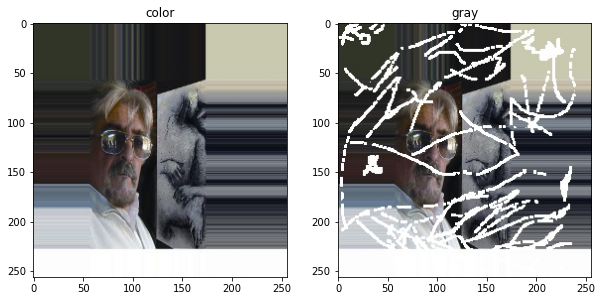

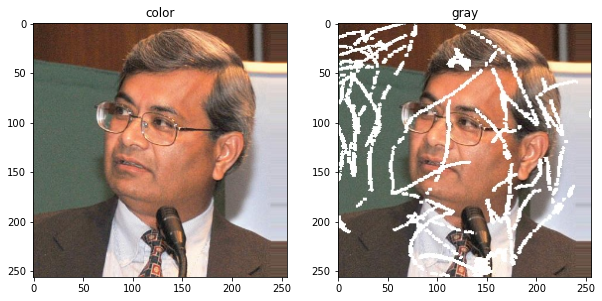

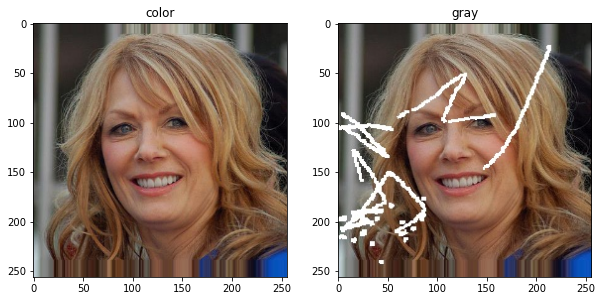

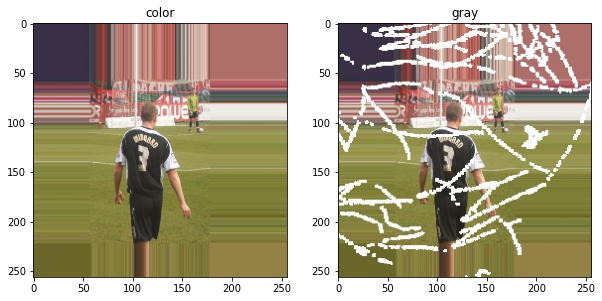

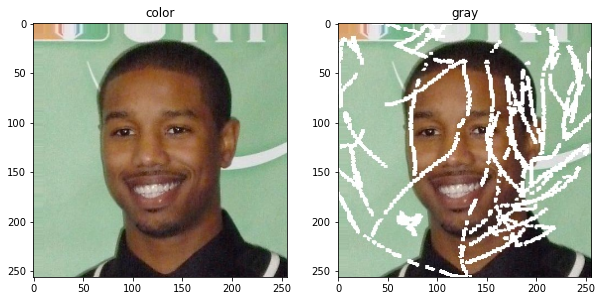

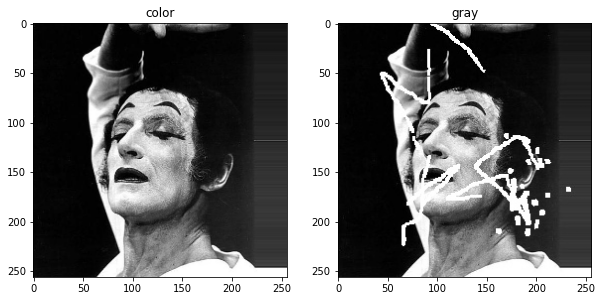

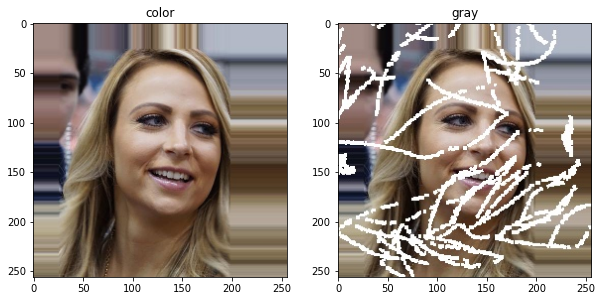

In [9]:
plot_images(7)

In [10]:
def downsample(filters, size, apply_batchnorm=True):
  
  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer='he_normal', use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

def upsample(filters, size, apply_dropout=False):
  

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer='he_normal',
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result  

In [11]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256,256,3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
    downsample(128, 4), # (bs, 64, 64, 128)
    downsample(256, 4), # (bs, 32, 32, 256)
    downsample(512, 4), # (bs, 16, 16, 512)
    downsample(512, 4), # (bs, 8, 8, 512)
    downsample(512, 4), # (bs, 4, 4, 512)
    downsample(512, 4), # (bs, 2, 2, 512)
    downsample(512, 4), # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
    upsample(512, 4), # (bs, 16, 16, 1024)
    upsample(256, 4), # (bs, 32, 32, 512)
    upsample(128, 4), # (bs, 64, 64, 256)
    upsample(64, 4), # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(3, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)


In [12]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)


In [13]:
generator = Generator()
generator.summary()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 128, 128, 64) 3072        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 64, 64, 128)  131584      sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 32, 32, 256)  525312      sequential_1[0][0]               
______________________________________________________________________________________________

In [14]:
discriminator = Discriminator()
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
target_image (InputLayer)       [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
concatenate_7 (Concatenate)     (None, 256, 256, 6)  0           input_image[0][0]                
                                                                 target_image[0][0]               
__________________________________________________________________________________________________
sequential_15 (Sequential)      (None, 128, 128, 64) 6144        concatenate_7[0][0]        

In [21]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

LAMBDA = 100

def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [23]:
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

 

In [24]:
import time
def fit(train_ds, epochs,):
  for epoch in range(epochs):
    start = time.time()

    print("Epoch: ", epoch+1)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      
      train_step(input_image, target, epoch)
    print()

  

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  


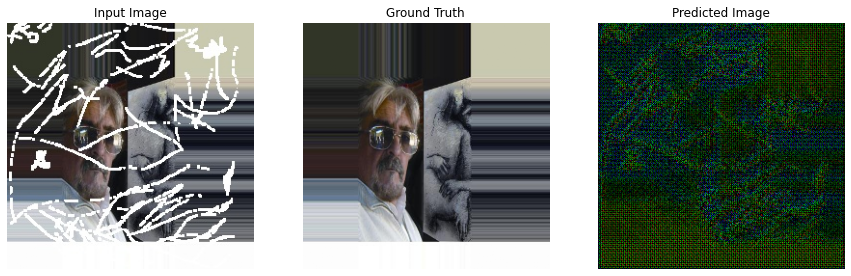

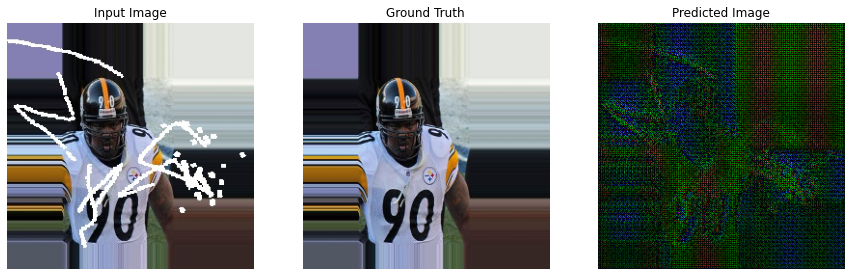

In [25]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()

for example_input, example_target in tf.data.Dataset.zip((gray_dataset,color_dataset)).take(2):
  generate_images(generator, example_input, example_target)


In [26]:
fit(tf.data.Dataset.zip((gray_dataset, color_dataset)),
    epochs = 100)

Epoch:  1

Time taken for epoch 1 is 117.26031064987183 sec

Epoch:  2

Time taken for epoch 2 is 118.38676977157593 sec

Epoch:  3

Time taken for epoch 3 is 118.2230875492096 sec

Epoch:  4

Time taken for epoch 4 is 118.04271674156189 sec

Epoch:  5

Time taken for epoch 5 is 118.08770203590393 sec

Epoch:  6

Time taken for epoch 6 is 117.97874689102173 sec

Epoch:  7

Time taken for epoch 7 is 117.9138572216034 sec

Epoch:  8

Time taken for epoch 8 is 118.0152108669281 sec

Epoch:  9

Time taken for epoch 9 is 117.91390466690063 sec

Epoch:  10

Time taken for epoch 10 is 117.94162821769714 sec

Epoch:  11

Time taken for epoch 11 is 118.06925511360168 sec

Epoch:  12

Time taken for epoch 12 is 117.92176914215088 sec

Epoch:  13

Time taken for epoch 13 is 118.16070604324341 sec

Epoch:  14

Time taken for epoch 14 is 117.83106184005737 sec

Epoch:  15

Time taken for epoch 15 is 118.30538058280945 sec

Epoch:  16

Time taken for epoch 16 is 117.73534607887268 sec

Epoch:  17

T

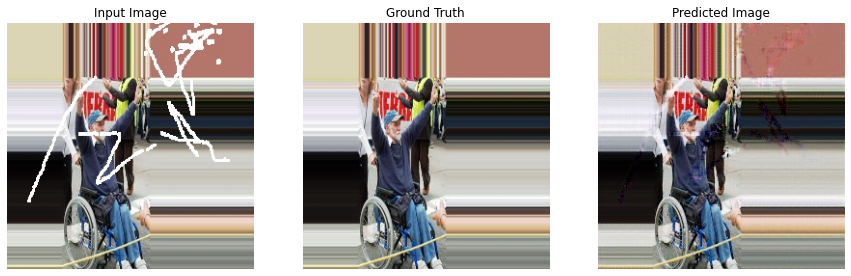

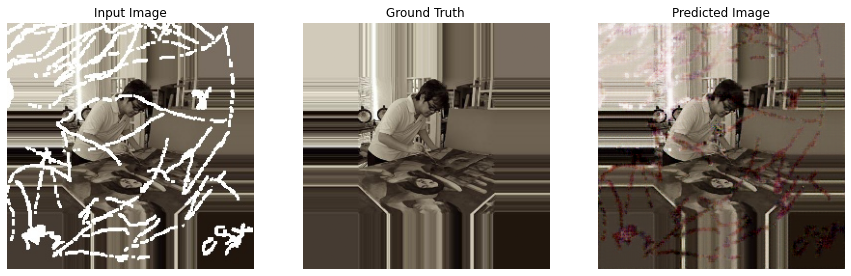

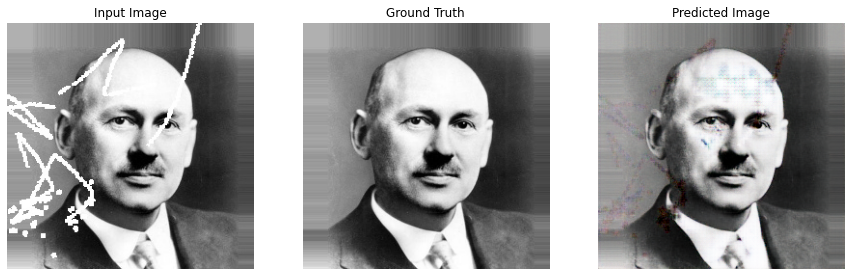

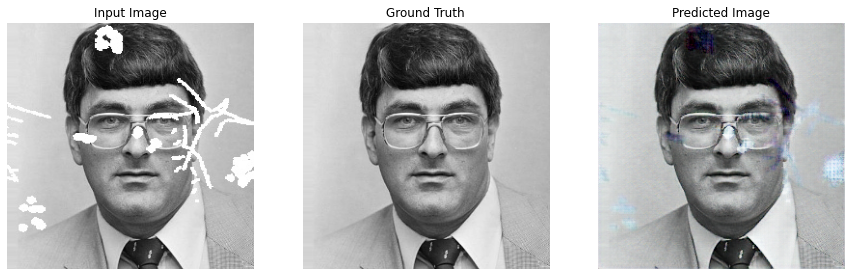

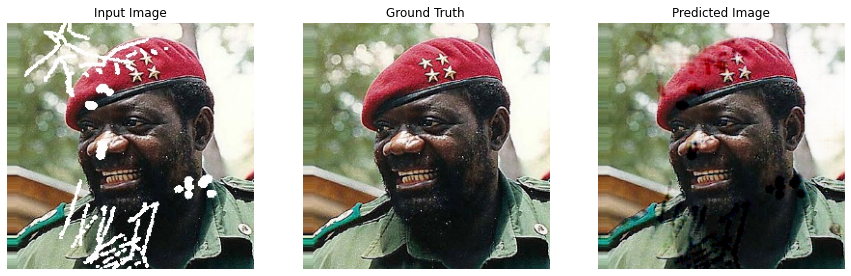

...

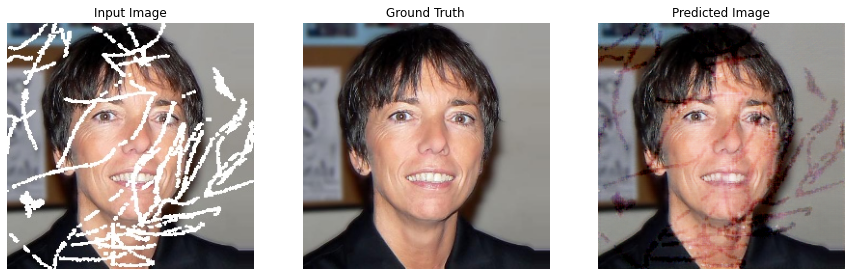

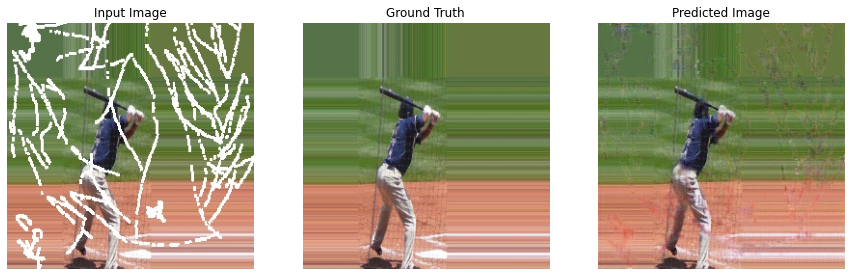

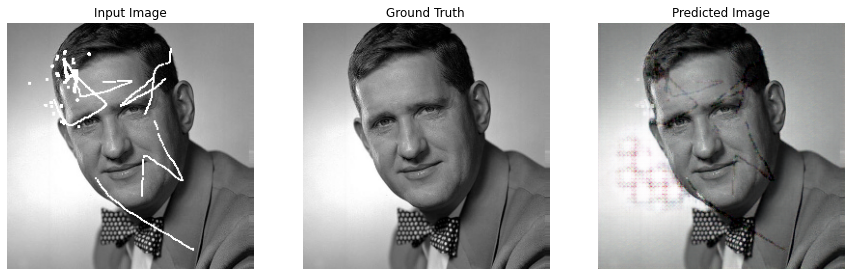

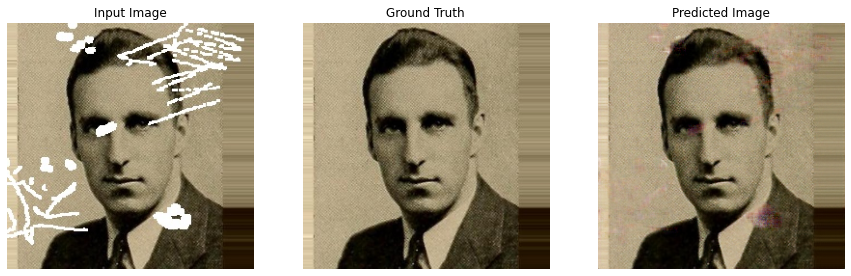

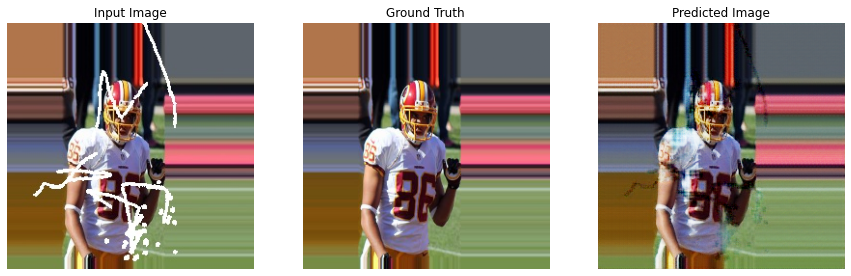

In [27]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()

for example_input, example_target in tf.data.Dataset.zip((gray_dataset_t,color_dataset_t)).take(40):
  generate_images(generator, example_input, example_target)


In [28]:
# Save the generator model
generator.save('generator_model.h5')

# Inference & Evaluation of the model

In [9]:
!cp -r /kaggle/input/restoreimage/keras/default/1/* /kaggle/working/

In [10]:
# Load the saved model
from keras.models import load_model
generator_loaded = load_model('generator_model.h5', compile=False)

**SSIM ( Structural Similarity Index)**

In [11]:
from skimage.metrics import structural_similarity as ssim

def calculate_ssim(true_images, generated_images):
    ssim_values = []
    for i in range(len(true_images)):
        ssim_val = ssim(true_images[i], generated_images[i], multichannel=True)
        ssim_values.append(ssim_val)
    return np.mean(ssim_values)

# Example usage
true_images = np.array([tar.numpy()[0] for _, tar in tf.data.Dataset.zip((gray_dataset_t, color_dataset_t)).take(1600)])
generated_images = [generator_loaded(input_image).numpy()[0] for input_image, _ in tf.data.Dataset.zip((gray_dataset_t, color_dataset_t)).take(1600)]

ssim_score = calculate_ssim(true_images, generated_images)
print("Average SSIM:", ssim_score)


Average SSIM: 0.9248756722787476


**PSNR (Peak Signal-to-Noise Ratio)**

In [12]:
from skimage.metrics import peak_signal_noise_ratio as psnr

def calculate_psnr(true_images, generated_images):
    psnr_values = []
    for i in range(len(true_images)):
        psnr_val = psnr(true_images[i], generated_images[i])
        psnr_values.append(psnr_val)
    return np.mean(psnr_values)

# Example usage
psnr_score = calculate_psnr(true_images, generated_images)
print("Average PSNR:", psnr_score)


Average PSNR: 28.42228841438635


**Inference random from dataset**

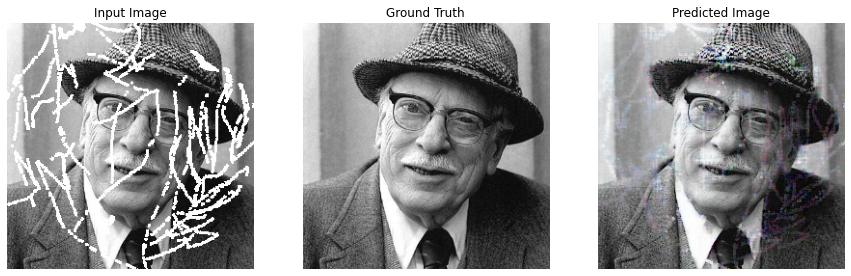

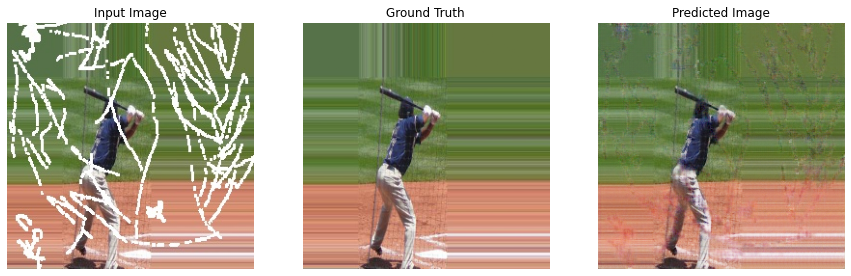

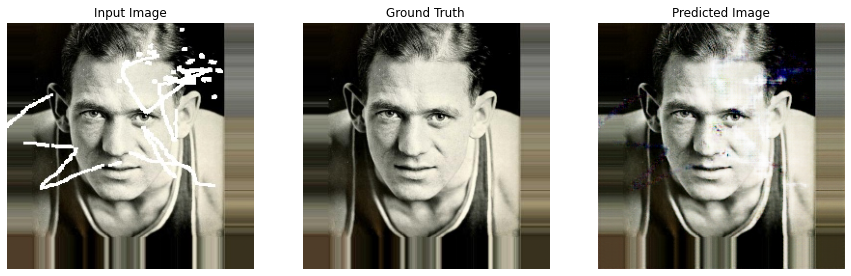

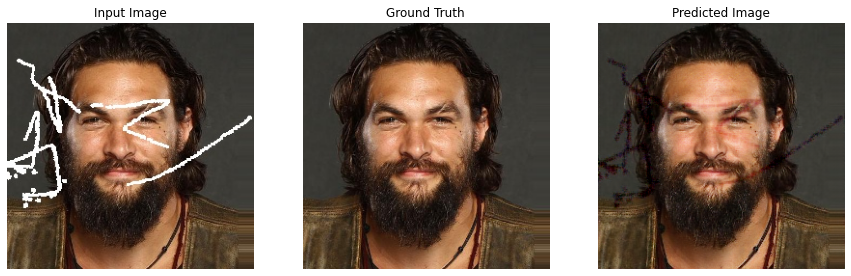

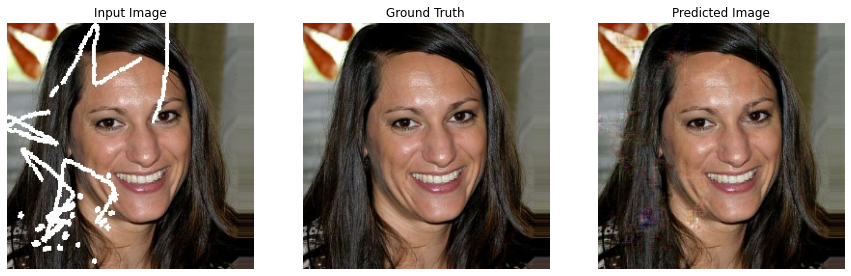

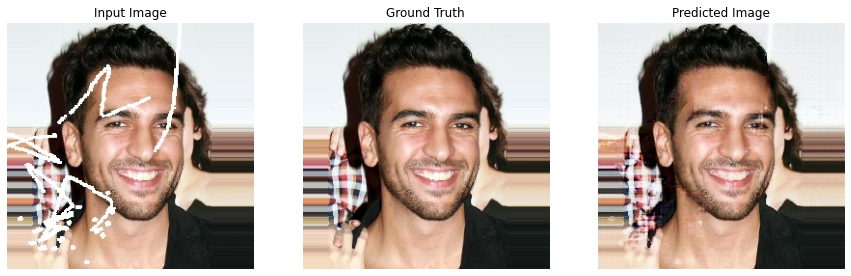

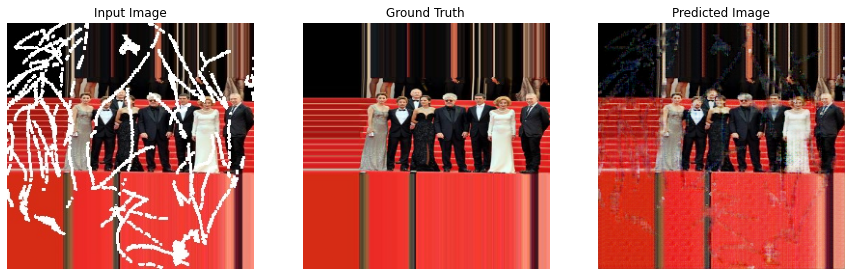

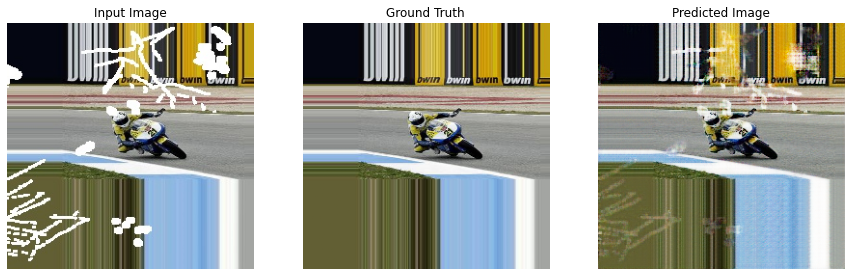

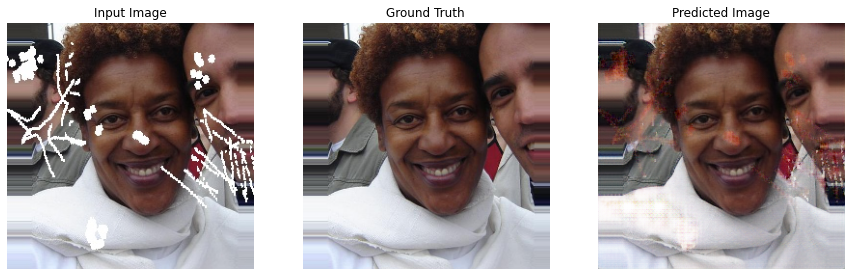

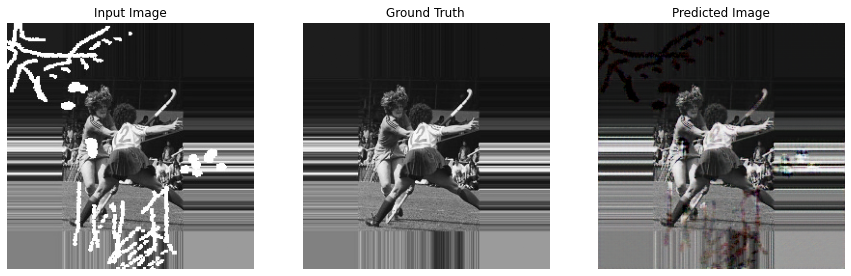

In [42]:
# Shuffle and take 10 random samples each time
shuffled_dataset = tf.data.Dataset.zip((gray_dataset_t, color_dataset_t)).shuffle(buffer_size=50)

# Generate images for 10 randomly shuffled samples
for example_input, example_target in shuffled_dataset.take(10):
    generate_images(generator_loaded, example_input, example_target)


In [54]:
import os
import matplotlib.pyplot as plt

# Create a results folder if it doesn't exist
results_folder = "results"
if not os.path.exists(results_folder):
    os.makedirs(results_folder)

# Function to save images side by side
def save_combined_images(generator_model, dataset, save_path, num_images=10):
    for idx, (input_image, target_image) in enumerate(dataset.take(num_images)):
        # Generate prediction
        predicted_image = generator_model(input_image, training=True)[0]

        # Combine images: Input (Old Photo) & Predicted (Restored Photo)
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        axes[0].imshow(input_image[0].numpy())
        axes[0].set_title("Input (Old Photo)")
        axes[0].axis("off")

        axes[1].imshow(predicted_image.numpy())
        axes[1].set_title("Predicted (Restored Photo)")
        axes[1].axis("off")

        # Save the combined image
        output_file = os.path.join(save_path, f"result_{idx+1}.png")
        plt.savefig(output_file)
        plt.close(fig)

# Save the images
save_combined_images(generator_loaded, shuffled_dataset, results_folder)


In [22]:
# Unbatch datasets
unbatched_gray = tf.data.Dataset.from_tensor_slices(np.array(gray_img[2000:]))
unbatched_color = tf.data.Dataset.from_tensor_slices(np.array(color_img[2000:]))

# Zip datasets
unbatched_dataset = tf.data.Dataset.zip((unbatched_gray, unbatched_color))

# Collect 1600 images
true_images = []
generated_images = []

for input_image, target_image in unbatched_dataset.take(1600):
    true_images.append(target_image.numpy())
    generated_images.append(generator_loaded(input_image[None, ...]).numpy()[0])

# Convert lists to numpy arrays
true_images = np.array(true_images)
generated_images = np.array(generated_images)

# Calculate SSIM
ssim_score = calculate_ssim(true_images, generated_images)
print("Average SSIM:", ssim_score)


Average SSIM: 0.923738211789701


Average PSNR: 28.527895


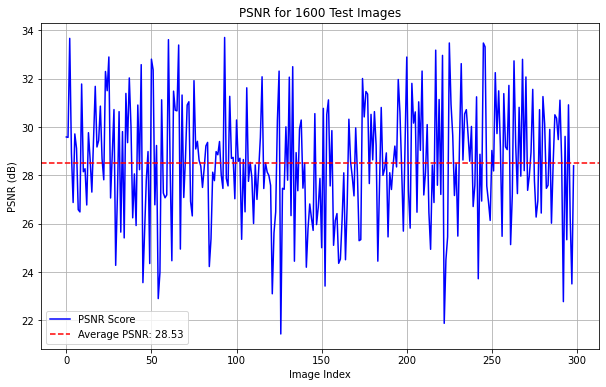

In [23]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# PSNR function
def calculate_psnr(true_images, generated_images):
    psnr_scores = []
    for true_img, gen_img in zip(true_images, generated_images):
        psnr = tf.image.psnr(true_img, gen_img, max_val=1.0)  # Assuming images are normalized [0, 1]
        psnr_scores.append(psnr.numpy())
    return psnr_scores

# Collect true and generated images (as done earlier)
true_images = []
generated_images = []

for input_image, target_image in unbatched_dataset.take(1600):
    true_images.append(target_image.numpy())
    generated_images.append(generator_loaded(input_image[None, ...]).numpy()[0])

true_images = np.array(true_images)
generated_images = np.array(generated_images)

# Calculate PSNR for each image
psnr_scores = calculate_psnr(true_images, generated_images)

# Average PSNR
average_psnr = np.mean(psnr_scores)
print("Average PSNR:", average_psnr)

# Plot PSNR scores
plt.figure(figsize=(10, 6))
plt.plot(psnr_scores, label="PSNR Score", color="blue")
plt.axhline(y=average_psnr, color='red', linestyle='--', label=f"Average PSNR: {average_psnr:.2f}")
plt.xlabel("Image Index")
plt.ylabel("PSNR (dB)")
plt.title("PSNR for 1600 Test Images")
plt.legend()
plt.grid(True)
plt.show()


Average SSIM: 0.9237382117924009
Average PSNR: 28.527896974191194


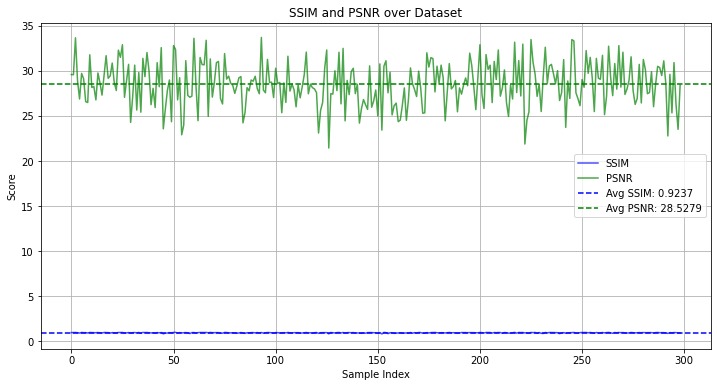

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

# Assuming true_images and generated_images are already prepared
# true_images and generated_images should have the shape (1600, 256, 256, 3)

# Calculate SSIM and PSNR for each image pair
ssim_values = [ssim(true_images[i], generated_images[i], multichannel=True) for i in range(len(true_images))]
psnr_values = [psnr(true_images[i], generated_images[i]) for i in range(len(true_images))]

# Average SSIM and PSNR
average_ssim = np.mean(ssim_values)
average_psnr = np.mean(psnr_values)

print(f"Average SSIM: {average_ssim}")
print(f"Average PSNR: {average_psnr}")

# Plot SSIM and PSNR
plt.figure(figsize=(12, 6))
plt.plot(ssim_values, label='SSIM', color='blue', alpha=0.7)
plt.plot(psnr_values, label='PSNR', color='green', alpha=0.7)
plt.axhline(y=average_ssim, color='blue', linestyle='--', label=f"Avg SSIM: {average_ssim:.4f}")
plt.axhline(y=average_psnr, color='green', linestyle='--', label=f"Avg PSNR: {average_psnr:.4f}")
plt.xlabel('Sample Index')
plt.ylabel('Score')
plt.title('SSIM and PSNR over Dataset')
plt.legend()
plt.grid(True)
plt.show()


In [25]:
print(f"Number of true images: {len(true_images)}")
print(f"Number of generated images: {len(generated_images)}")

Number of true images: 299
Number of generated images: 299


In [27]:
true_images = []
generated_images = []

for input_image, target_image in unbatched_dataset.take(1600):
    # Add batch dimension to input image
    input_image_batch = tf.expand_dims(input_image, axis=0)
    # Generate output
    generated_image = generator_loaded(input_image_batch).numpy()[0]
    
    true_images.append(target_image.numpy())
    generated_images.append(generated_image)

print(f"Collected {len(true_images)} true images and {len(generated_images)} generated images.")


Collected 299 true images and 299 generated images.


# Inference on real life old photos with scrumble damage to the image

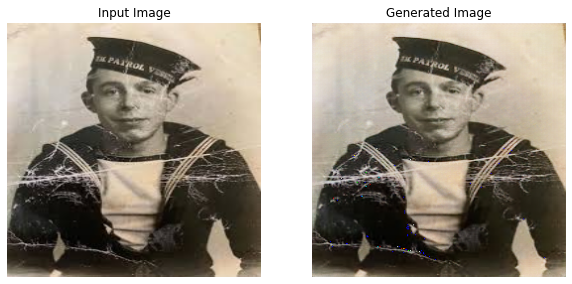

In [53]:
def infer_on_image(generator_model, image_path):
    # Step 1: Load and preprocess the image
    SIZE = 256  # Image size for the model
    img = cv2.imread(image_path, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
    img_resized = cv2.resize(img, (SIZE, SIZE))  # Resize to (256, 256)
    img_normalized = img_resized.astype('float32') / 255.0  # Normalize to [0, 1]
    img_tensor = np.expand_dims(img_normalized, axis=0)  # Add batch dimension
    
    # Step 2: Run inference
    generated_image = generator_model(img_tensor, training=False)
    generated_image = generated_image[0].numpy()  # Remove batch dimension
    
    # Step 3: Postprocess and display
    generated_image = (generated_image * 255).astype('uint8')  # Convert back to [0, 255]
    
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Input Image")
    plt.imshow(img_resized)
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title("Generated Image")
    plt.imshow(generated_image)
    plt.axis('off')
    plt.show()

# Example usage
image_path = "/kaggle/input/kuchbhi2/five.jpg"
infer_on_image(generator_loaded, image_path)
